## Install toolkit

In [1]:
!git clone https://github.com/PonceLab/circuit_toolkit

Cloning into 'circuit_toolkit'...
remote: Enumerating objects: 54, done.
remote: Counting objects: 100% (54/54), done.
remote: Compressing objects: 100% (42/42), done.
remote: Total 54 (delta 17), reused 43 (delta 9), pack-reused 0
Unpacking objects: 100% (54/54), 57.12 KiB | 3.17 MiB/s, done.


In [2]:
%cd circuit_toolkit
%pip install -e .
%pip install -r requirements.txt

/content/circuit_toolkit
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/circuit_toolkit
  Preparing metadata (setup.py) ... done
  Running setup.py develop for circuit-toolkit
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 59.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 111.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 27.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 80.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 152.9/152.9 kB 10.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.6/135.6 kB 16.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 77.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [68]:
%cd circuit_toolkit/
!git pull

[Errno 2] No such file or directory: 'circuit_toolkit/'
/content/circuit_toolkit/circuit_toolkit
remote: Enumerating objects: 14, done.
remote: Counting objects: 100% (14/14), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 9 (delta 4), reused 8 (delta 3), pack-reused 0
Unpacking objects: 100% (9/9), 3.24 KiB | 1.62 MiB/s, done.
From https://github.com/PonceLab/circuit_toolkit
   c6b26e9..23be5b0  main       -> origin/main
Updating c6b26e9..23be5b0
Fast-forward
 README.md                                 | 64 ++++++++++++++++++++++++++++++-
 circuit_toolkit/Evol_utils.py             | 56 +++++++++++++++++++++++++++
 experiments/BigGAN_Evol_cmp_O2_cluster.py | 25 ------------
 3 files changed, 119 insertions(+), 26 deletions(-)
 create mode 100644 circuit_toolkit/Evol_utils.py


## Use toolkit

In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from circuit_toolkit.CNN_scorers import TorchScorer
from circuit_toolkit.Optimizers import CholeskyCMAES
from circuit_toolkit.GAN_utils import upconvGAN
from circuit_toolkit.layer_hook_utils import get_module_names
from circuit_toolkit.plot_utils import to_imgrid

## Record Unit

In [3]:
scorer = TorchScorer("alexnet", imgpix=224)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [4]:
#@title Print out all layers in a model
get_module_names(scorer.model, (3, 224,224), device="cuda");

------------------------------------------------------------------------------
      Layer Id       inshape       outshape           Type                 ReadableStr 
        0        (3, 224, 224) (3, 224, 224)           Input                      Image
        1        (3, 224, 224) (64, 55, 55)          Conv2d          .features.Conv2d0
        2        (64, 55, 55) (64, 55, 55)            ReLU            .features.ReLU1
        3        (64, 55, 55) (64, 27, 27)       MaxPool2d       .features.MaxPool2d2
        4        (64, 27, 27) (192, 27, 27)          Conv2d          .features.Conv2d3
        5        (192, 27, 27) (192, 27, 27)            ReLU            .features.ReLU4
        6        (192, 27, 27) (192, 13, 13)       MaxPool2d       .features.MaxPool2d5
        7        (192, 13, 13) (384, 13, 13)          Conv2d          .features.Conv2d6
        8        (384, 13, 13) (384, 13, 13)            ReLU            .features.ReLU7
        9        (384, 13, 13) (256, 13, 13)   

In [5]:
h = scorer.set_unit("score", ".features.ReLU11", (10,6,6), ingraph=False)

## Map Receptive Field

In [84]:
from circuit_toolkit.grad_RF_estim import grad_RF_estimate, grad_population_RF_estimate, show_gradmap, gradmap2RF_square, fit_2dgauss

Unit ('alexnet', '.features.ReLU11', 10, 6, 6)


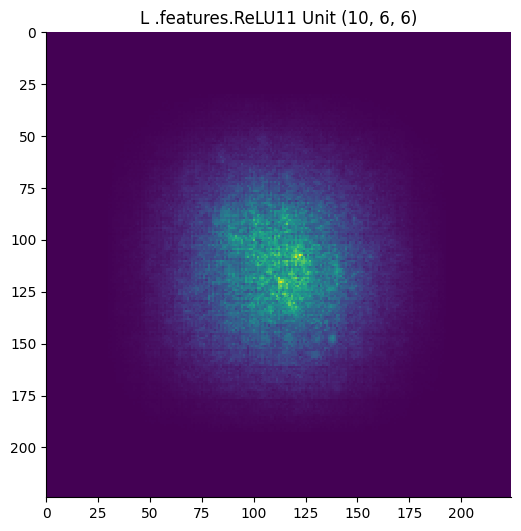

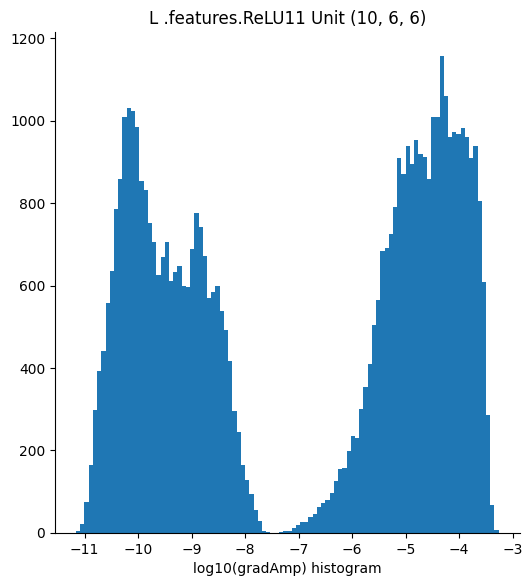

Modify window to be square, before (32, 191), (32, 193)
After (31, 192), (32, 193)
Xlim (31, 192) Ylim (32, 193)
imgsize (161, 161) corner (31, 32)


In [86]:
unit = ("alexnet", ".features.ReLU11", 10, 6, 6)
print("Unit %s" % (unit,))
gradAmpmap = grad_RF_estimate(scorer.model, ".features.ReLU11", (10,6,6), 
                        input_size=(3, 224, 224), device="cuda", show=True, 
                        reps=100, batch=10)
Xlim, Ylim = gradmap2RF_square(gradAmpmap, absthresh=1E-8, relthresh=0.01, square=True)
print("Xlim %s Ylim %s\nimgsize %s corner %s" % (
Xlim, Ylim, (Xlim[1] - Xlim[0], Ylim[1] - Ylim[0]), (Xlim[0], Ylim[0])))

Fit a Gaussian model to it 

Gaussian Fitting center (112.8, 111.0)
 Cov mat XX 843.0 YY 780.9 XY 18.3


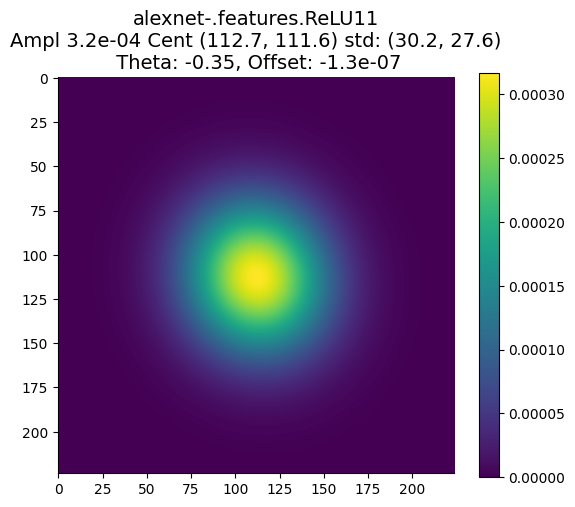

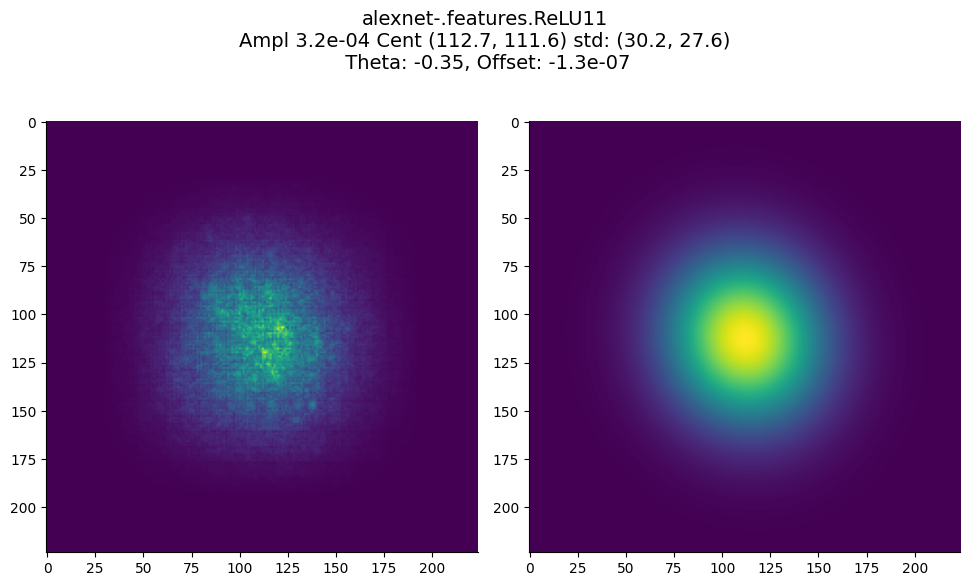

In [87]:
fitdict = fit_2dgauss(gradAmpmap, f"{unit[0]}-"+unit[1], outdir="", plot=True)

## Record Image Selectivity

In [6]:
from tqdm.notebook import tqdm, trange
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
from torchvision.transforms import Compose, Resize, ToTensor, Normalize, CenterCrop

In [34]:
#@title Download the smaller Imagenette dataset
!wget https://s3.amazonaws.com/fast-ai-imageclas/imagenette2-160.tgz
!tar -xzf imagenette2-160.tgz

--2023-05-27 01:31:29--  https://s3.amazonaws.com/fast-ai-imageclas/imagenette2-160.tgz
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.217.46.190, 54.231.202.216, 52.216.214.48, ...
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.217.46.190|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 99003388 (94M) [application/x-tar]
Saving to: ‘imagenette2-160.tgz’

imagenette2-160.tgz 100%[===================>]  94.42M  27.3MB/s    in 3.6s    

2023-05-27 01:31:33 (26.0 MB/s) - ‘imagenette2-160.tgz’ saved [99003388/99003388]



In [24]:
dataset = ImageFolder("imagenette2-160/train", transform=Compose([CenterCrop(130), 
                                                                  Resize(224),
                                                                  ToTensor(), ]))# Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
dataloader = DataLoader(dataset, batch_size=128, shuffle=False, num_workers=4)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [63]:
score_vec = []
label_vec = []
for imgs, labels in tqdm(dataloader):
    scores = scorer.score_tsr(imgs, B=128,)
    score_vec.append(scores)
    label_vec.append(labels)

score_vec = np.concatenate(score_vec, axis=0)
label_vec = torch.cat(label_vec, dim=0)

  0%|          | 0/74 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


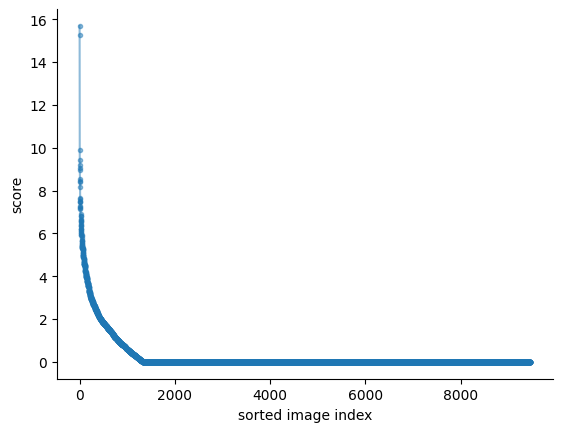

In [78]:
plt.figure()
plt.plot(np.sort(score_vec)[::-1], ".-",alpha=0.5)
plt.ylabel("score")
plt.xlabel("sorted image index")
plt.show()

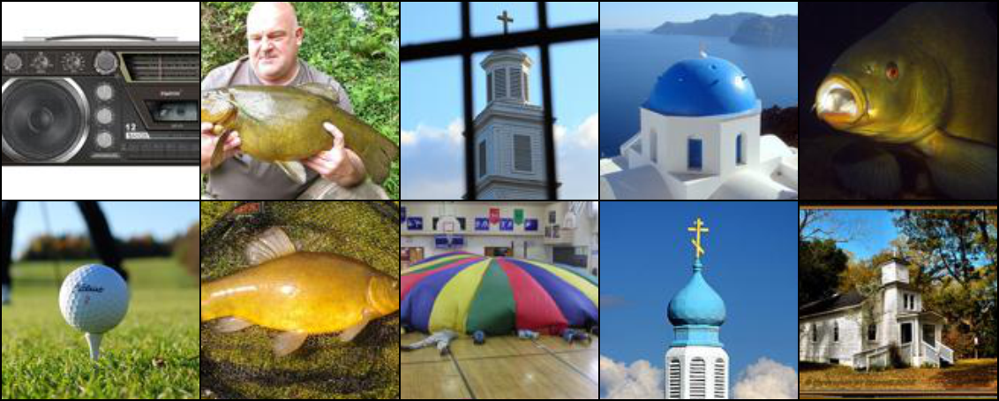

In [71]:
topk_idx = np.argsort(score_vec, axis=0)[-10:]
topk_score = score_vec[topk_idx]
topk_label = label_vec[topk_idx]
topk_imgs = [dataset[idx][0] for idx in topk_idx]
mtg = to_imgrid(topk_imgs, nrow=5)
mtg

## Run Evolution

In [9]:
G = upconvGAN("fc6").cuda().eval()
G.requires_grad_(False);

In [17]:
new_codes = np.random.randn(1, 4096)
optimizer = CholeskyCMAES(space_dimen=4096, init_code=new_codes, init_sigma=3.0,)
steps = 100
for i in range(steps):
    latent_code = torch.from_numpy(np.array(new_codes)).float()
    imgs = G.visualize(latent_code.cuda()).cpu()
    scores = scorer.score_tsr(imgs)
    new_codes = optimizer.step_simple(scores, new_codes, )
    print("step %d score %.3f (%.3f) (norm %.2f )" % (
            i, scores.mean(), scores.std(), latent_code.norm(dim=1).mean(),))

Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 3.000
cc=0.001, cs=0.050, c1=0.000 damps=1.050
step 0 score 0.000 (0.000) (norm 64.00 )
sigma: 2.90
step 1 score 0.455 (1.016) (norm 201.82 )
sigma: 2.83
step 2 score 1.236 (2.202) (norm 204.18 )
sigma: 2.76
step 3 score 1.901 (2.424) (norm 207.98 )
sigma: 2.71
step 4 score 1.312 (2.085) (norm 210.72 )
sigma: 2.66
step 5 score 3.295 (3.082) (norm 214.19 )
sigma: 2.62
step 6 score 4.285 (4.365) (norm 218.13 )
sigma: 2.59
step 7 score 4.452 (3.590) (norm 222.07 )
sigma: 2.56
step 8 score 5.594 (3.809) (norm 226.01 )
sigma: 2.53
step 9 score 5.474 (3.881) (norm 229.11 )
sigma: 2.51
step 10 score 7.370 (4.931) (norm 233.48 )
sigma: 2.49
A, Ainv update! Time cost: 0.34 s
step 11 score 12.713 (6.156) (norm 237.72 )
sigma: 2.47
step 12 score 14.536 (6.244) (norm 241.27 )
sigma: 2.45
step 13 score 18.966 (6.191) (norm 245.86 )
sigma: 2.44
step 14 score 17.855 (6.765) (norm 250.35 )
sigma: 2.43
s

A more elaborated version of Evolution and visualization

In [11]:
scores_all = []
generations = []
codes_all = []
best_imgs = []
new_codes = np.random.randn(1, 4096)
optimizer = CholeskyCMAES(space_dimen=4096, init_code=new_codes, init_sigma=3.0,)
steps = 50
for i in range(steps):
    codes_all.append(new_codes.copy())
    latent_code = torch.from_numpy(np.array(new_codes)).float()
    # imgs = G.visualize_batch_np(new_codes) # B=1
    imgs = G.visualize(latent_code.cuda()).cpu()
    scores = scorer.score_tsr(imgs)
    new_codes = optimizer.step_simple(scores, new_codes, )
    print("step %d score %.3f (%.3f) (norm %.2f )" % (
            i, scores.mean(), scores.std(), latent_code.norm(dim=1).mean(),))
    scores_all.extend(list(scores))
    generations.extend([i] * len(scores))
    best_imgs.append(imgs[scores.argmax(),:,:,:])

codes_all = np.concatenate(tuple(codes_all), axis=0)
scores_all = np.array(scores_all)
generations = np.array(generations)

Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 3.000
cc=0.001, cs=0.050, c1=0.000 damps=1.050
step 0 score 0.000 (0.000) (norm 64.17 )
sigma: 2.90
step 1 score 0.320 (0.918) (norm 202.78 )
sigma: 2.83
step 2 score 0.726 (1.578) (norm 204.59 )
sigma: 2.76
step 3 score 2.106 (2.745) (norm 207.33 )
sigma: 2.71
step 4 score 2.113 (2.467) (norm 211.27 )
sigma: 2.66
step 5 score 3.674 (3.671) (norm 214.53 )
sigma: 2.62
step 6 score 5.773 (3.332) (norm 218.11 )
sigma: 2.58
step 7 score 8.600 (4.592) (norm 221.68 )
sigma: 2.55
step 8 score 10.210 (5.087) (norm 225.57 )
sigma: 2.53
step 9 score 11.343 (4.255) (norm 229.80 )
sigma: 2.50
step 10 score 13.092 (4.153) (norm 233.92 )
sigma: 2.48
A, Ainv update! Time cost: 0.53 s
step 11 score 13.872 (4.547) (norm 237.03 )
sigma: 2.46
step 12 score 16.428 (5.434) (norm 241.31 )
sigma: 2.45
step 13 score 17.344 (4.873) (norm 245.93 )
sigma: 2.43
step 14 score 18.868 (3.966) (norm 249.60 )
sigma: 2.4

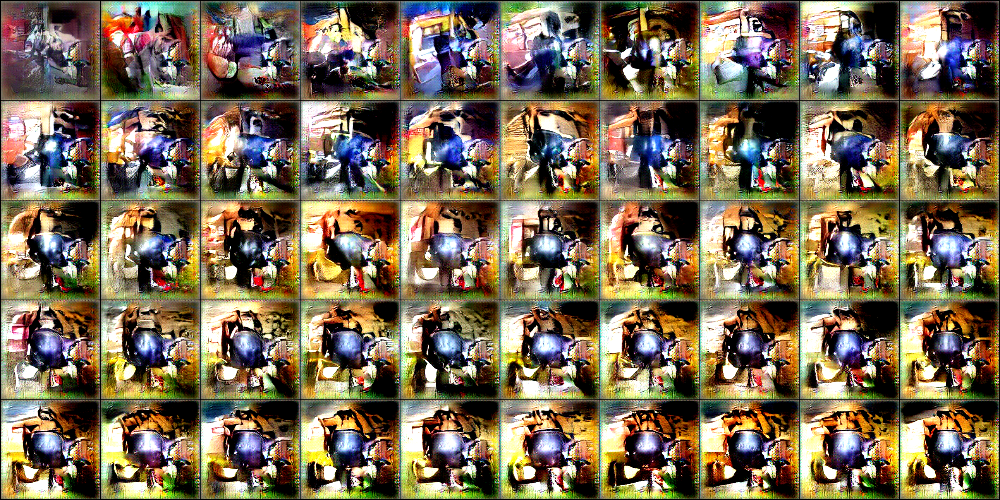

In [15]:
to_imgrid(best_imgs,nrow=10)

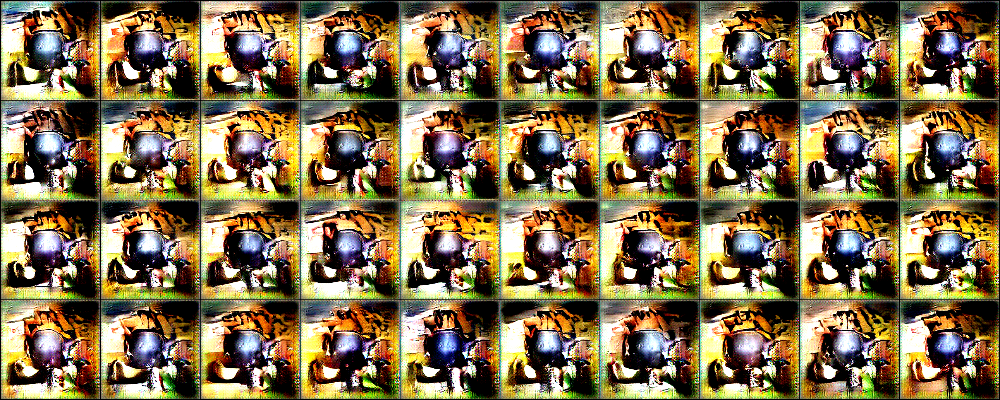

In [16]:
to_imgrid(imgs,nrow=10)

In [69]:
from circuit_toolkit.Evol_utils import Evol_experiment_FC6

In [71]:
optimizer = CholeskyCMAES(space_dimen=4096, init_code=None, init_sigma=3.0,)
codes_all, scores_all, generations, best_imgs, \
 final_imgs = Evol_experiment_FC6(scorer, optimizer, G, steps=100)

Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 3.000
cc=0.001, cs=0.050, c1=0.000 damps=1.050
step 0 score 0.000 (0.000) (norm 64.30 )
sigma: 2.90
step 1 score 0.691 (1.191) (norm 201.62 )
sigma: 2.83
step 2 score 1.571 (1.824) (norm 204.44 )
sigma: 2.76
step 3 score 3.113 (3.685) (norm 208.49 )
sigma: 2.71
step 4 score 5.751 (4.032) (norm 212.19 )
sigma: 2.67
step 5 score 6.661 (3.953) (norm 216.52 )
sigma: 2.63
step 6 score 9.182 (3.936) (norm 219.90 )
sigma: 2.59
step 7 score 11.676 (6.103) (norm 223.85 )
sigma: 2.56
step 8 score 14.546 (4.613) (norm 227.25 )
sigma: 2.54
step 9 score 16.253 (4.910) (norm 232.12 )
sigma: 2.51
step 10 score 18.152 (5.262) (norm 235.53 )
sigma: 2.49
A, Ainv update! Time cost: 0.78 s
step 11 score 19.863 (6.191) (norm 239.05 )
sigma: 2.48
step 12 score 21.161 (4.522) (norm 243.22 )
sigma: 2.46
step 13 score 24.759 (4.525) (norm 247.28 )
sigma: 2.45
step 14 score 25.538 (5.895) (norm 251.85 )
sigma: 2.

## Run Manifold Exploration

In [19]:
from circuit_toolkit.GAN_manifold_utils import generate_sphere_grid_coords, \
    generate_azel_xyz_grid, generate_orthogonal_vectors_torch

Choose any vector as the central vector 

In [20]:
vec_cnt = torch.from_numpy(codes_all[-1,:]).float()
# vec_cnt = 3 * torch.randn(1,4096)

Using 2 random orthogonal vector to perturb the center vector. 

In [21]:
codes = generate_sphere_grid_coords(vec_cnt, vec2=None, vec3=None,
                    n_az=9, n_el=9, az_lim=(-np.pi/2, np.pi/2),
                          el_lim=(-np.pi/2, np.pi/2))

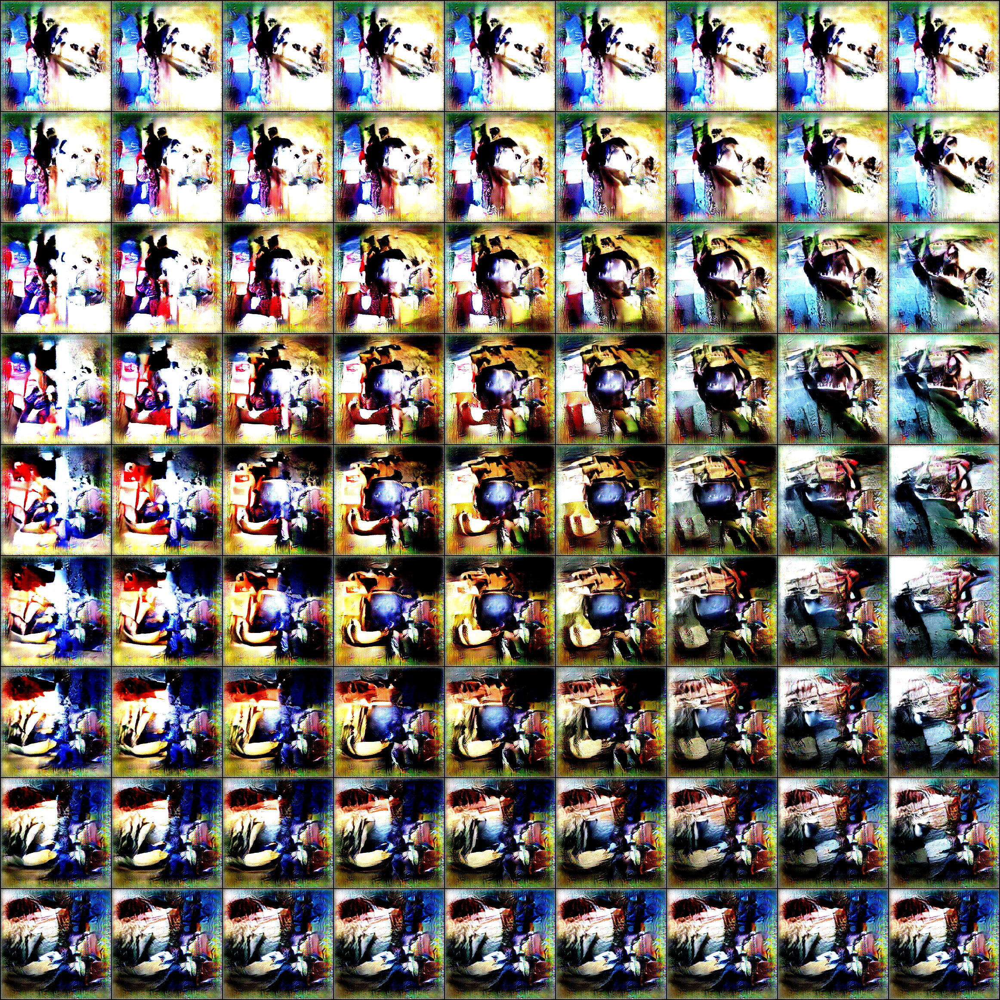

In [22]:
manif_imgs = G.visualize_batch(codes, B=40)
to_imgrid(manif_imgs,nrow=9)

In [63]:
manif_imgs.shape

torch.Size([81, 3, 256, 256])

Score the manifold images with the scorers:

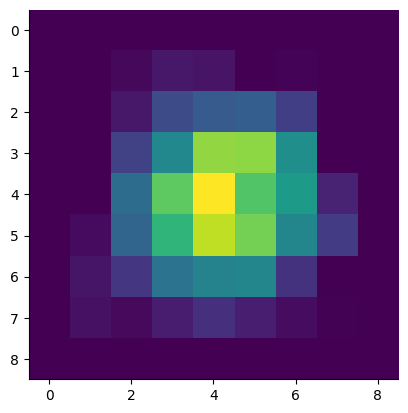

In [67]:
manif_scores = scorer.score_tsr(manif_imgs)
plt.imshow(manif_scores.reshape(9,9))
plt.show()

## GAN Image Inversion

In [49]:
from circuit_toolkit.GAN_invert_utils import GAN_invert

In [26]:
#@title Download target cat image
from PIL import Image
import requests
from io import BytesIO
response = requests.get("https://upload.wikimedia.org/wikipedia/commons/thumb/b/b6/Felis_catus-cat_on_snow.jpg/1280px-Felis_catus-cat_on_snow.jpg")
img = Image.open(BytesIO(response.content))
img = img.crop((200,0,1000,800)) # center crop
img = img.resize((256,256))

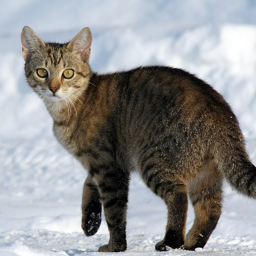

In [42]:
img

In [44]:
target_img = ToTensor()(img)

In [60]:
z_opts, img_opts = GAN_invert(G, target_img.cuda(), max_iter=int(5E3),
                              z_init=torch.randn(5,4096).cuda(), 
                              print_progress=False)

  0%|          | 0/5000 [00:00<?, ?it/s]

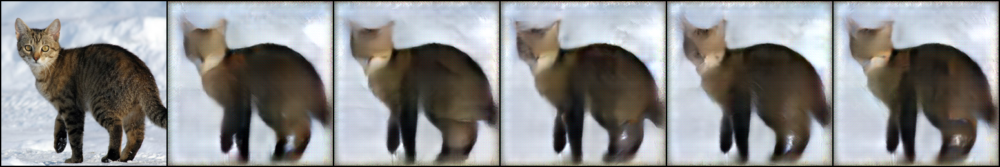

In [61]:
to_imgrid([target_img,*img_opts.cpu()])

## Clean up

In [100]:
torch.cuda.empty_cache()

In [101]:
!nvidia-smi

Sat May 27 02:11:47 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   48C    P0    27W /  70W |  15045MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------